# Example Notebook 1: Feature extraction

This notebook demonstrates the feature extraction and sonification using MusTen. 

In [1]:
#Please install all libraries you have not yet installed using !pip install 

%matplotlib inline
from __future__ import print_function

import librosa.display
import librosa
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Audio

from scipy.ndimage.filters import uniform_filter1d


import dissonant
import os
import scipy
import pandas as pd

import import_ipynb
from scipy import stats
import spleeter

from pydub import AudioSegment
import soundfile
from scipy.signal import savgol_filter
from scipy import signal
import scipy.signal

In [5]:
%run Only_features.ipynb     #defining our custom functions
%run tension_functions.ipynb    


We start with loading the audio and simultaneously trimming the audio in case there is silence before or after the music. 

In [6]:
file_name = "Mozart"
inpath = "../music_files/"
outpath = "./music_trim/"
sr = 44100

y,sr,trimmed_audio_path = music_loading(file_name, inpath, outpath, sr)

../music_files/Mozart.wav


## Feature extraction

Estimating loudness...


Text(0, 0.5, 'Loudness')

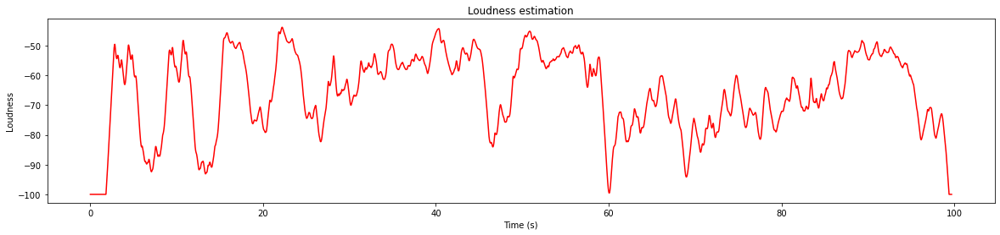

In [7]:
# Loudness
loudness,t_loudness = extract_loudness(y,sr)

#Plotting the tempo
plt.figure(figsize = [20,4])
plt.title('Loudness estimation')
plt.plot(t_loudness, loudness[0], color='r', linewidth=1.5)
plt.xlabel('Time (s)')
plt.ylabel('Loudness')

Estimating tempo...


Text(0, 0.5, 'BPM')

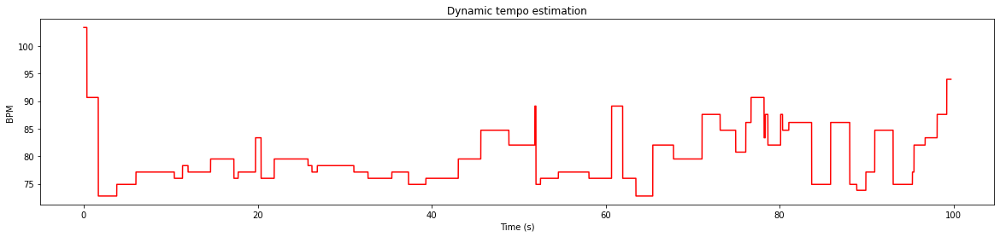

In [8]:
#Tempo
[tempo, t_tempo] = tempo_extraction(y,sr, start_bpm = 80)

#Plotting the tempo
plt.figure(figsize = [20,4])
plt.title('Dynamic tempo estimation')
plt.plot(t_tempo, tempo, color='r', linewidth=1.5, label='Tempo estimate')
plt.xlabel('Time (s)')
plt.ylabel('BPM')

Estimating Onset frequency...


Text(0, 0.5, 'Onset frequency')

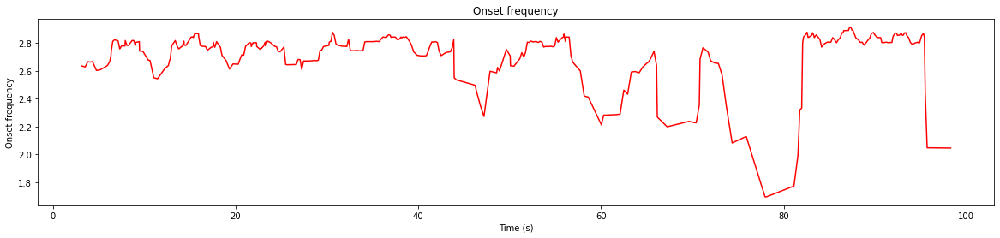

In [14]:
#Onset
[onset_env, onset_freq, t_onset] = onset_frequency(y,sr)

#Plotting the onset frequency
plt.figure(figsize = [20,4])
plt.title('Onset frequency')
plt.plot(t_onset, onset_freq, color='r', linewidth=1.5)
plt.xlabel('Time (s)')
plt.ylabel('Onset frequency')


Estimating Pitch...
Estimating polyphone pitch using Deep Salience
Computing HCQT...
Computing salience...
   > 1 / 9
1/1 [==============================] - 5s 5s/step
   > 2 / 9
1/1 [==============================] - 7s 7s/step
   > 3 / 9
1/1 [==============================] - 6s 6s/step
   > 4 / 9
1/1 [==============================] - 6s 6s/step
   > 5 / 9
1/1 [==============================] - 6s 6s/step
   > 6 / 9
1/1 [==============================] - 7s 7s/step
   > 7 / 9
1/1 [==============================] - 7s 7s/step
   > 8 / 9
1/1 [==============================] - 7s 7s/step
   > 9 / 9
1/1 [==============================] - 4s 4s/step
Saving output...


Text(0, 0.5, 'Pitch (Hz)')

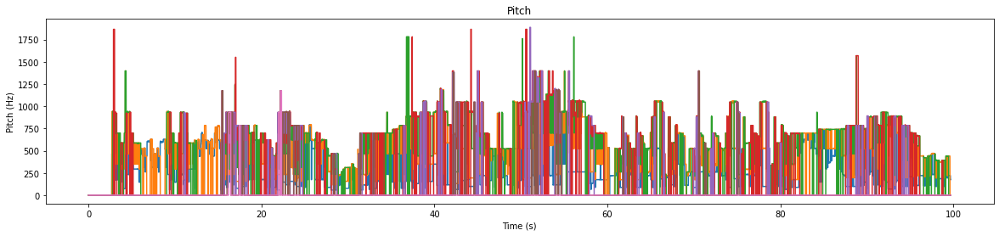

In [15]:
#pitches
#We use polyphonic pitch estimation, since the piece is polyphonic. The toolbox includes additional methods 
#for vocal pieces and solo music

pitch_df = pitch_extraction(trimmed_audio_path,sr,category = "polyphonic")

#Plotting the Pitch 
plt.figure(figsize = [20,4])
plt.title('Pitch')
for col in pitch_df.columns:
    if col != 'time':
        plt.plot(pitch_df['time'], pitch_df[col], linewidth=1.5)
        
plt.xlabel('Time (s)')
plt.ylabel('Pitch (Hz)')


Estimating dissonance...


Text(0, 0.5, 'Dissonance')

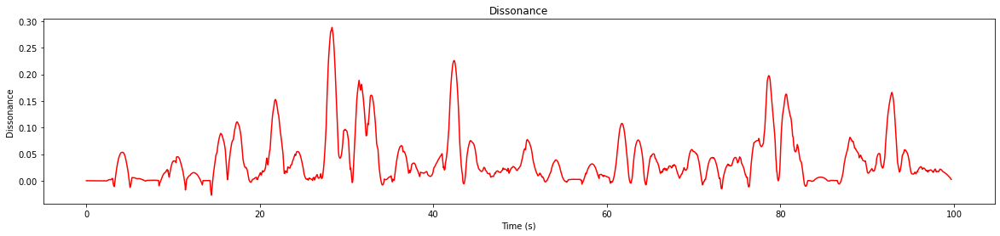

In [16]:
#Dissonance
[dissonance, t_dissonance] = dissonance_extraction(pitch_df, sr)

#Plotting the Dissonance
plt.figure(figsize = [20,4])
plt.title('Dissonance')
plt.plot(t_dissonance, dissonance, color = "red", lw = 1.5)
plt.xlabel('Time (s)')
plt.ylabel('Dissonance')


## Feature sonification

For some features, the toolbox includes methods to sonify the features in order to evaluate their extraction "by ear".

In [17]:
#Tempo (beats)
aud = tempo_evaluation(y,sr, start_bpm = 80)

audio = ipd.Audio(aud, rate=sr) 
audio = AudioSegment(audio.data, frame_rate=sr, sample_width=2, channels=1) 

#To save the audio:
#audio.export("tempo_Mozart.wav", format="wav", bitrate="64k")

Here, the clicks mark every beat that was extracted by the toolbox. These beats are then used for the tempo estimation. If the beat extraction does not match your expectation, you can try to adjust the parameter start_bpm. The default is at 80 bpm, which might not be accurate for every piece. 

If you change start_bpm in here and receive a more satisfying result, it is recommended to also adjust this parameter during the tempo estimation.

In [18]:
#Onset frequency (Onsets)
aud = onset_evaluation(onset_env,y,sr)

audio = ipd.Audio(aud, rate=sr) 
audio = AudioSegment(audio.data, frame_rate=sr, sample_width=2, channels=1) 

#To save the audio:
#audio.export("Onsets_Mozart.wav", format="wav", bitrate="64k")


To evaluate the onset detection, the clicks in this audio mark every onset that was detected by the toolbox. These onsets are then used to estimate the onset frequency. 

In [19]:
#Pitch
all_aud, sonified_pitches = evaluate_polyphonic_pitch(pitch_df, sr)

audio = ipd.Audio(all_aud, rate=sr) 
audio = AudioSegment(audio.data, frame_rate=sr, sample_width=2, channels=1) 

#To save the audio:
#audio.export("Pitch_Mozart.wav", format="wav", bitrate="64k")

Here, you hear the pitches that were estimated by the pitch estimation. While this may sound a little messier than the original audio, the melody of the piece you entered should definitely by recognizable.

Now that we extracted all features, we can continue with the tension prediction. An example for this will be provided in example notebook 2.